In [118]:
# Part a: The Reporting of the Data Sets

In [119]:
import numpy as np
import pandas as pd

In [120]:
departments = ['nottinghamshire-street', 'south-wales-street', 'staffordshire-street', 'surrey-street']
year = 2022

In [121]:
def data_reading():
    data = {}
    files_location = './dataset'
    for month in range(2,11):
        key =  f'{year}-0{month}'
        if len(str(month)) == 2:
            key = f'{year}-{month}'
        data[key] = {}
    
    for key in data:
        for department in departments:
            df = pd.read_csv(f'{files_location}/{str(key)}/{str(key)}-{department}.csv')
            df = df.drop(['Crime ID','Context', 'LSOA code', 'LSOA name'], axis =1)
            data[key][department] = df
    
    return data

data = data_reading()

In [122]:
data

{'2022-02': {'nottinghamshire-street':          Month             Reported by            Falls within  Longitude  \
  0      2022-02  Nottinghamshire Police  Nottinghamshire Police  -1.376821   
  1      2022-02  Nottinghamshire Police  Nottinghamshire Police  -1.366642   
  2      2022-02  Nottinghamshire Police  Nottinghamshire Police  -1.366642   
  3      2022-02  Nottinghamshire Police  Nottinghamshire Police  -1.403397   
  4      2022-02  Nottinghamshire Police  Nottinghamshire Police  -1.396091   
  ...        ...                     ...                     ...        ...   
  10399  2022-02  Nottinghamshire Police  Nottinghamshire Police        NaN   
  10400  2022-02  Nottinghamshire Police  Nottinghamshire Police        NaN   
  10401  2022-02  Nottinghamshire Police  Nottinghamshire Police        NaN   
  10402  2022-02  Nottinghamshire Police  Nottinghamshire Police        NaN   
  10403  2022-02  Nottinghamshire Police  Nottinghamshire Police        NaN   
  
          La

In [123]:
def departmentStats(data,police_department):
    print(f"For Department: {police_department.upper()} \nCrime Details per month are as follow:")
    for month in range(2,11):
        key =  f'{year}-0{month}'
        if len(str(month)) == 2:
            key = f'{year}-{month}'
        print(f"\nFor {key}:")
        print(data[key][police_department]['Crime type'].value_counts())
    

while True:
    try:
        department = int(input("Please Choose the Department:\n1)nottinghamshire-street\n2)south-wales-street\n3)staffordshire-street\n4)surrey-street\n"))
        if department in [1,2,3,4]:
            break
        else:
            raise Exception
    except:
        print("Please enter valid department number [1-4]")

departmentStats(data,departments[department-1])
    

Please Choose the Department:
1)nottinghamshire-street
2)south-wales-street
3)staffordshire-street
4)surrey-street
1
For Department: NOTTINGHAMSHIRE-STREET 
Crime Details per month are as follow:

For 2022-02:
Violence and sexual offences    3287
Anti-social behaviour           2174
Shoplifting                      914
Criminal damage and arson        869
Other theft                      673
Public order                     670
Vehicle crime                    523
Burglary                         450
Drugs                            292
Other crime                      209
Bicycle theft                    105
Possession of weapons             92
Robbery                           79
Theft from the person             67
Name: Crime type, dtype: int64

For 2022-03:
Violence and sexual offences    3428
Anti-social behaviour           2662
Criminal damage and arson       1067
Shoplifting                      886
Public order                     784
Other theft                      761
Vehic

In [124]:
def monthlyStats(data,month_val,month_name,departments_name):
    print(f"For Month: {month_name.upper()} \nCrime Details per department are as follow:")
    for department in departments_name:
        key =  f'{year}-0{month_val}'
        if len(str(month_val)) == 2:
            key = f'{year}-{month_val}'
            
        print(f"\nFor {department} Police Dartment:")
        print(data[key][department]['Crime type'].value_counts())
        print("---------------------------------------------------------")
        print("Total Cases\t\t\t",data[key][department]['Crime type'].value_counts().sum())
    

while True:
    try:
        month = int(input("Please Choose the Month:\n2)February\n3)March\n4)April\n5)May\n6)June\n7)July\n8)August\n9)September\n10)October\n"))
        if month>=2 and month<=10:
            break
        else:
            raise Exception
    except:
        print("Please select valid month [2-10]")

month_mapping = {2:'february',3:'march',4:'april',5:'may',6:'june',7:'july',8:'august',9:'september',10:'october'}     
monthlyStats(data,month,month_mapping[month],departments)
    

Please Choose the Month:
2)February
3)March
4)April
5)May
6)June
7)July
8)August
9)September
10)October
3
For Month: MARCH 
Crime Details per department are as follow:

For nottinghamshire-street Police Dartment:
Violence and sexual offences    3428
Anti-social behaviour           2662
Criminal damage and arson       1067
Shoplifting                      886
Public order                     784
Other theft                      761
Vehicle crime                    587
Burglary                         483
Other crime                      343
Drugs                            305
Robbery                          124
Possession of weapons            117
Bicycle theft                    101
Theft from the person             94
Name: Crime type, dtype: int64
---------------------------------------------------------
Total Cases			 11742

For south-wales-street Police Dartment:
Violence and sexual offences    3751
Anti-social behaviour           1779
Public order                    1177
Crimina

In [125]:
def vulnerablePlacePerDepartment():
    for month in range(2,11):
        print(f"\nFor {year}-{month}:")
        for department in departments:
            key =  f'{year}-0{month}'
            if len(str(month)) == 2:
                key = f'{year}-{month}'
            print(f"Department: {department} (Top 2 Vulnerable Places)")
            print(data[key][department]['Location'].value_counts().index.tolist()[0:2])

    
vulnerablePlacePerDepartment()


For 2022-2:
Department: nottinghamshire-street (Top 2 Vulnerable Places)
['On or near Supermarket', 'On or near Parking Area']
Department: south-wales-street (Top 2 Vulnerable Places)
['On or near Shopping Area', 'On or near Parking Area']
Department: staffordshire-street (Top 2 Vulnerable Places)
['On or near Parking Area', 'On or near Supermarket']
Department: surrey-street (Top 2 Vulnerable Places)
['On or near Parking Area', 'On or near Petrol Station']

For 2022-3:
Department: nottinghamshire-street (Top 2 Vulnerable Places)
['On or near Supermarket', 'On or near Parking Area']
Department: south-wales-street (Top 2 Vulnerable Places)
['On or near Parking Area', 'No Location']
Department: staffordshire-street (Top 2 Vulnerable Places)
['On or near Parking Area', 'On or near Supermarket']
Department: surrey-street (Top 2 Vulnerable Places)
['On or near Parking Area', 'On or near Supermarket']

For 2022-4:
Department: nottinghamshire-street (Top 2 Vulnerable Places)
['On or near Sup

In [60]:
# Part b: The Analysis of the Data Sets

In [126]:
def moving_average(a, n=4) :
    ret = np.cumsum(a, dtype=float)
    ret[n:] = ret[n:] - ret[:-n]
    return ret[n - 1:] / n

def crimeComparison(crime1,crime2):
    crime1_list = []
    crime2_list = []
    for month in range(2,11):
        crime1_sum = 0
        crime2_sum = 0
        for department in departments:
            key =  f'{year}-0{month}'
            if len(str(month)) == 2:
                key = f'{year}-{month}'
            crime1_sum = crime1_sum + data[key][department]['Crime type'].value_counts()[crime1]
            crime2_sum = crime2_sum + data[key][department]['Crime type'].value_counts()[crime2]
        crime1_list.append(crime1_sum)
        crime2_list.append(crime2_sum)
    
    if sum(crime1_list) > sum(crime2_list):
        print(f"Crime:{crime1} is more than Crime:{crime2}")
    else:
        print(f"{crime2} is more than {crime1}")
    
    print("\nGeneral trend of crimes are as follow:")
    if np.all(np.diff(moving_average(np.array(crime1_list), n=4))>0):
        print(f"{crime1} is generally increasing over time")
    else:
        print(f"{crime1} is generally decreasing over time")
    
    if np.all(np.diff(moving_average(np.array(crime2_list), n=4))>0):
        print(f"{crime2} is generally increasing over time")
    else:
        print(f"{crime2} is generally decreasing over time")
        
    

crimeComparison("Violence and sexual offences","Anti-social behaviour")
    

Crime:Violence and sexual offences is more than Crime:Anti-social behaviour

General trend of crimes are as follow:
Violence and sexual offences is generally decreasing over time
Anti-social behaviour is generally decreasing over time


In [128]:
import math
def crimePercentage(crime):
    overall_crime = 0
    crime_sum = 0
    for month in range(2,11):
        for department in departments:
            key =  f'{year}-0{month}'
            if len(str(month)) == 2:
                key = f'{year}-{month}'
            overall_crime = overall_crime + data[key][department]['Crime type'].value_counts().sum()
            crime_sum = crime_sum + data[key][department]['Crime type'].value_counts()[crime]
            
    
    percentage = (crime_sum/overall_crime)*100
    print(f"{crime} cover {math.floor(percentage)}% of overall crimes.")
    
crimePercentage('Anti-social behaviour')  
    

Anti-social behaviour cover 18% of overall crimes.


In [129]:
def crimeTrend():
    crimesPerMonth = []
    crimePerMonth = 0
    for month in range(2,11):
        for department in departments:
            key =  f'{year}-0{month}'
            if len(str(month)) == 2:
                key = f'{year}-{month}'
            crimePerMonth = crimePerMonth + data[key][department]['Crime type'].value_counts().sum()
        crimesPerMonth.append(crimePerMonth)
    
    if np.all(np.diff(moving_average(np.array(crimesPerMonth), n=4))>0):
        print(f"Crimes are generally increasing over time")
    else:
        print(f"Crimes are generally decreasing over time")

crimeTrend()  

Crimes are generally increasing over time


In [130]:
def quaterSum(crime,start,end):
    quater = []
    for month in range(start,end):
        for department in departments:
            key =  f'{year}-0{month}'
            if len(str(month)) == 2:
                key = f'{year}-{month}'
            quater.append(data[key][department]['Crime type'].value_counts()[crime])
    return quater

def specificCrimeTrend(crime):
    first_quater = quaterSum(crime,2,6)
    second_quater = quaterSum(crime,6,10)
    if sum(first_quater) > sum(second_quater):
        print("Crimes Reduce during last quater months (July To September) Compare to (Feb to May)")
    else:
        print("Crimes Increase during last quater months (July To September) Compare to (Feb to May)")


specificCrimeTrend("Anti-social behaviour")

Crimes Reduce during last quater months (July To September) Compare to (Feb to May)


In [65]:
# Part c: The Visualization of the Data Sets

Please Choose the Department:
1)nottinghamshire-street
2)south-wales-street
3)staffordshire-street
4)surrey-street
1
Please Choose the Month:
2)February
3)March
4)April
5)May
6)June
7)July
8)August
9)September
10)October
10


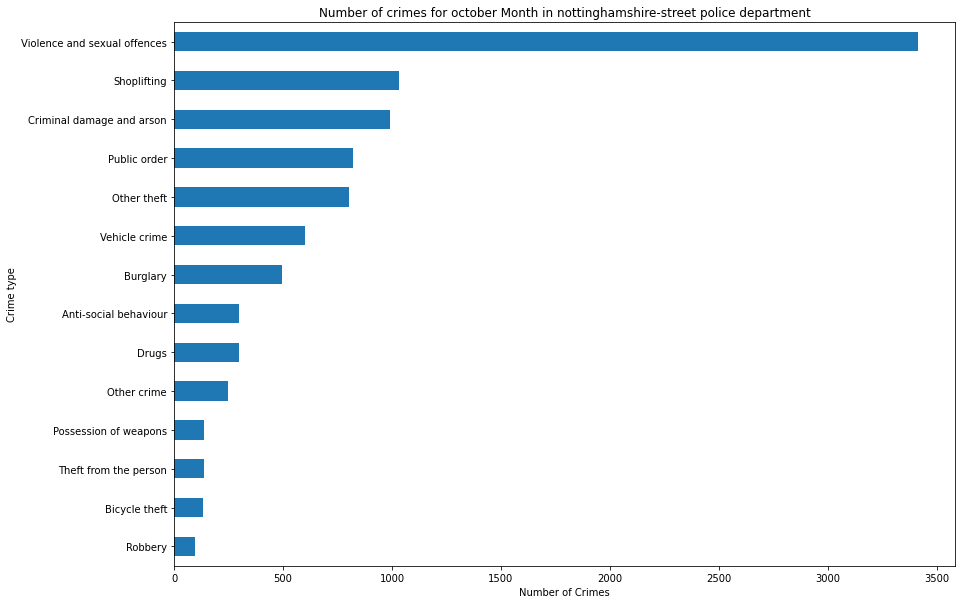

In [131]:
import matplotlib.pyplot as plt
def horizontalBarchart(department,monthname,month):
    key =  f'{year}-0{month}'
    if len(str(month)) == 2:
        key = f'{year}-{month}'
        
    plt.figure(figsize=(14,10))
    plt.title(f'Number of crimes for {monthname} Month in {department} police department')
    plt.ylabel('Crime Type')
    plt.xlabel('Number of Crimes')
    data[key][department].groupby([data[key][department]['Crime type']]).size().sort_values(ascending=True).plot(kind='barh')
    plt.show()


while True:
    try:
        department = int(input("Please Choose the Department:\n1)nottinghamshire-street\n2)south-wales-street\n3)staffordshire-street\n4)surrey-street\n"))
        if department in [1,2,3,4]:
            break
        else:
            raise Exception
    except:
        print("Please enter valid department number [1-4]")

while True:
    try:
        month = int(input("Please Choose the Month:\n2)February\n3)March\n4)April\n5)May\n6)June\n7)July\n8)August\n9)September\n10)October\n"))
        if month>=2 and month<=10:
            break
        else:
            raise Exception
    except:
        print("Please select valid month [2-10]")
    
horizontalBarchart(departments[department-1],month_mapping[month],month)

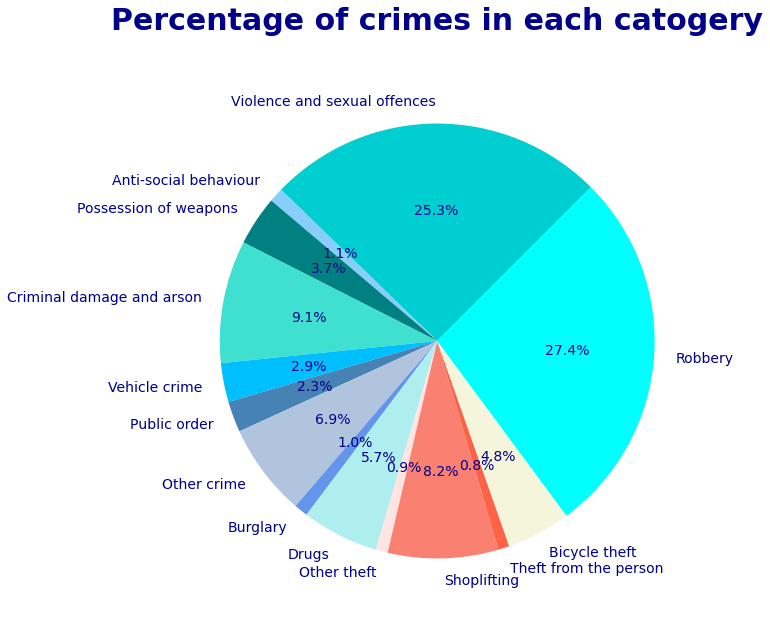

In [132]:
def piechart():
    font1 = {
        'color':  'darkblue',
        'weight': 'bold',
        'size': 30,
        }

    lables=data['2022-04']['nottinghamshire-street']['Crime type'].unique()

    sizes=data['2022-04']['nottinghamshire-street'].groupby(data['2022-04']['nottinghamshire-street']['Crime type']).size()
    colors=['darkturquoise','lightskyblue','teal','turquoise','deepskyblue','steelblue','lightsteelblue',
            'cornflowerblue','paleturquoise','mistyrose','salmon','tomato','beige','aqua']
    plt.figure(figsize=(20,10))
    ax = plt.axes()
    ax.set_facecolor("lightblue")
    plt.title('Percentage of crimes in each catogery\n',fontdict=font1)
    ab=plt.pie(sizes, labels=lables, colors=colors, startangle=45,autopct='%1.1f%%', textprops={'fontsize': 14,'color':'darkblue'})
    plt.show()

piechart()
    

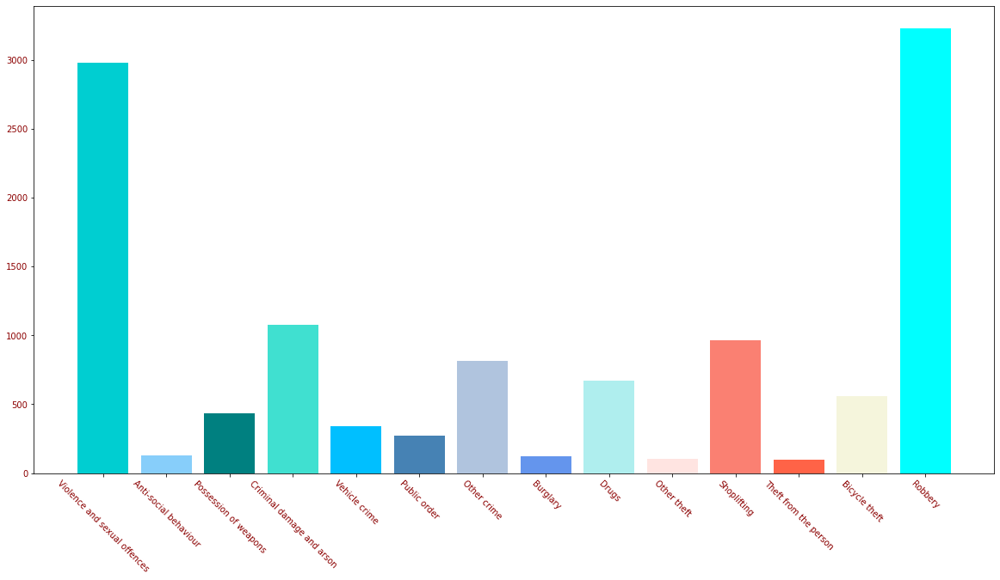

In [133]:
def barChart():
    font = {
            'color':  'darkred',
            'weight': 'bold',
            'size': 30,
            }

    label=data['2022-04']['nottinghamshire-street']['Crime type'].unique()

    totals=data['2022-04']['nottinghamshire-street'].groupby(data['2022-04']['nottinghamshire-street']['Crime type']).size()

    Totals=totals.to_numpy()

    colors1=['darkturquoise','lightskyblue','teal','turquoise','deepskyblue','steelblue','lightsteelblue',
                'cornflowerblue','paleturquoise','mistyrose','salmon','tomato','beige','aqua']
    plt.figure(figsize=(20,10))
    plt.xticks(rotation=-45)
    plt.xticks(fontsize=10,color='darkred')
    plt.yticks(fontsize=10,color='darkred')

    plt.bar(label,Totals,color=colors1)
    plt.show()


barChart()

In [134]:
pip install seaborn

Note: you may need to restart the kernel to use updated packages.


(49.0, 55.0)

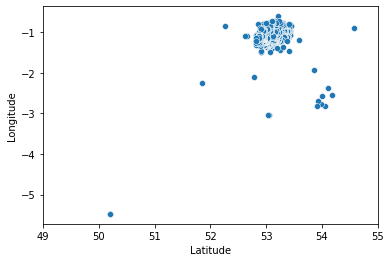

In [135]:
import seaborn as sns
sns.scatterplot(x="Latitude", y="Longitude", data=data['2022-04']['nottinghamshire-street'])
plt.xlim(49,55)

In [136]:
# Part d: Advanced Analysis and/or Visualisation

In [137]:
# Crime Map

In [138]:
pip install descartes

Note: you may need to restart the kernel to use updated packages.


In [139]:
pip install geopandas

Note: you may need to restart the kernel to use updated packages.


In [140]:
import descartes
import geopandas as gpd
from shapely.geometry import Point,Polygon


<AxesSubplot:>

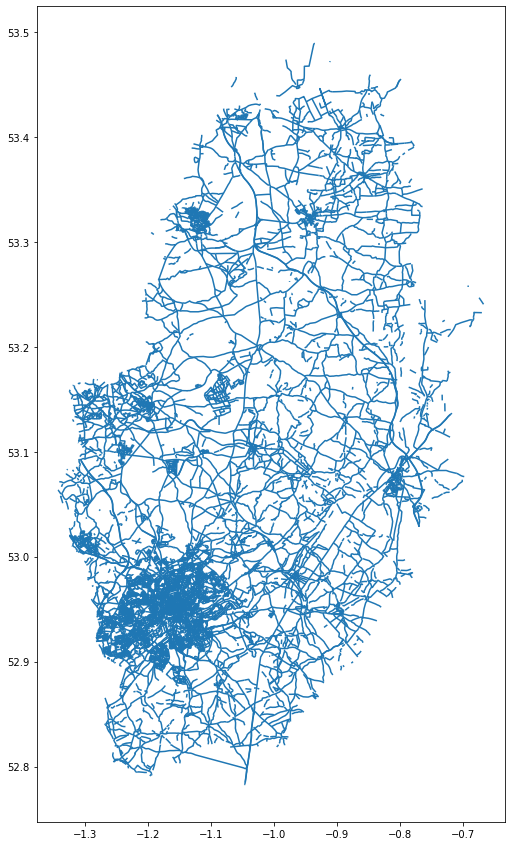

In [141]:
map = gpd.read_file('./map/roads.shp')
fig,ax = plt.subplots(figsize=(15,15))
map.plot(ax=ax)

In [142]:
map_data = data['2022-02']['nottinghamshire-street']
crs = {'init': 'epsg:4326'}
map_data.head()

,Month,Reported by,Falls within,Longitude,Latitude,Location,Crime type,Last outcome category
0,2022-02,Nottinghamshire Police,Nottinghamshire Police,-1.376821,53.039341,On or near Hollywell Avenue,Public order,Unable to prosecute suspect
1,2022-02,Nottinghamshire Police,Nottinghamshire Police,-1.366642,53.067370,On or near Stewart Street,Violence and sexual offences,Status update unavailable
2,2022-02,Nottinghamshire Police,Nottinghamshire Police,-1.366642,53.067370,On or near Stewart Street,Violence and sexual offences,Status update unavailable
3,2022-02,Nottinghamshire Police,Nottinghamshire Police,-1.403397,53.049195,On or near Wellington Street,Public order,Unable to prosecute suspect
4,2022-02,Nottinghamshire Police,Nottinghamshire Police,-1.396091,53.046758,On or near Mill Hill Close,Violence and sexual offences,Unable to prosecute suspect


In [143]:
geometry = [Point(xy) for xy in zip(map_data.Longitude, map_data.Latitude)]
geometry[:4]

In [144]:
crime_locs = gpd.GeoDataFrame(map_data, crs=crs, geometry=geometry)
crime_locs.head()

C:\Users\Umer\AppData\Local\Programs\Python\Python310\lib\site-packages\pyproj\crs\crs.py:141: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)


,Month,Reported by,Falls within,Longitude,Latitude,Location,Crime type,Last outcome category,geometry
0,2022-02,Nottinghamshire Police,Nottinghamshire Police,-1.376821,53.039341,On or near Hollywell Avenue,Public order,Unable to prosecute suspect,POINT (-1.37682 53.03934)
1,2022-02,Nottinghamshire Police,Nottinghamshire Police,-1.366642,53.067370,On or near Stewart Street,Violence and sexual offences,Status update unavailable,POINT (-1.36664 53.06737)
2,2022-02,Nottinghamshire Police,Nottinghamshire Police,-1.366642,53.067370,On or near Stewart Street,Violence and sexual offences,Status update unavailable,POINT (-1.36664 53.06737)
3,2022-02,Nottinghamshire Police,Nottinghamshire Police,-1.403397,53.049195,On or near Wellington Street,Public order,Unable to prosecute suspect,POINT (-1.40340 53.04919)
4,2022-02,Nottinghamshire Police,Nottinghamshire Police,-1.396091,53.046758,On or near Mill Hill Close,Violence and sexual offences,Unable to prosecute suspect,POINT (-1.39609 53.04676)


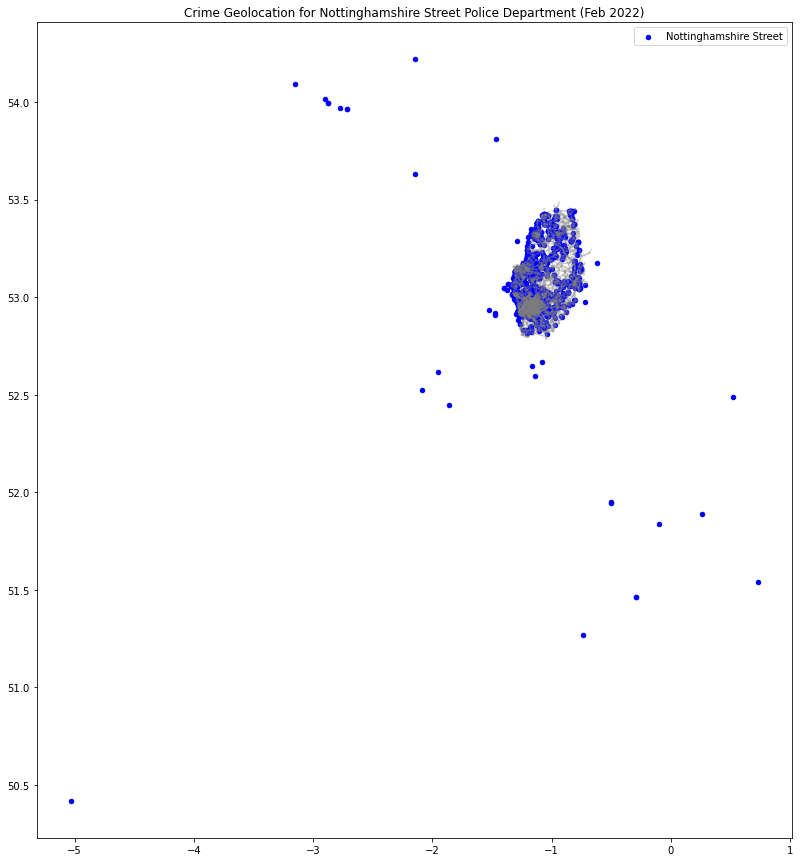

In [145]:
fig, ax = plt.subplots(figsize = (15,15))
map.plot(color='grey', ax=ax, alpha=0.4)

crime_locs.plot(marker='o', color = 'blue', ax = ax, label = 'Nottinghamshire Street',markersize = 20 )

plt.title('Crime Geolocation for Nottinghamshire Street Police Department (Feb 2022)')
plt.legend()

In [146]:
# Folium maps

In [147]:
pip install folium

Note: you may need to restart the kernel to use updated packages.


In [148]:
import folium
from folium import plugins
from folium.plugins import MarkerCluster

In [149]:
df = data['2022-02']['nottinghamshire-street']
df = df.dropna()

In [150]:
# folium marker map

In [151]:
# Mark events with names on map
m = folium.Map([53.039341,-1.376821], zoom_start=14)
for index, row in df.iterrows():
    folium.CircleMarker([row['Latitude'], row['Longitude']],
                        radius=3,
                        popup=row['Crime type'],
                        fill_color="#3db7e4", # divvy color
                       ).add_to(m)
m


In [152]:
# folium heat map

In [153]:
# convert to (n, 2) nd-array format for heatmap
dfmatrix = df[['Latitude', 'Longitude']].values
# plot heatmap
m.add_child(plugins.HeatMap(dfmatrix, radius=15))
m